# xDbit Quality assessment


## Library import

In [1]:
## The following code ensures that all functions and init files are reloaded before executions.
%load_ext autoreload
%autoreload 2

In [2]:
## Import the custom library
import os
import sys

# add xDbit toolbox path to path variable
module_path = os.path.abspath("../../")
if module_path not in sys.path:
    sys.path.append(module_path)

import xdbit_funcs as db

In [38]:
import matplotlib.pyplot as plt
from glob import glob
from pathlib import Path
import scanpy as sc
import anndata
import gc
import seaborn as sns
import pandas as pd

In [4]:
plt.rcParams['figure.dpi'] = 100
plt.style.use('default')

 # Quality control of Registration and Transcriptome

## Datasets: 37_38, 37_46

In [5]:
# give directories with anndata files
anndata_dirs = [
    "D:/data/37_38/anndata/",
    "D:/data/37_46/anndata/"
]

# get list of files
in_files = []
for d in anndata_dirs:
    in_files.extend(glob(os.path.join(d, "*h5ad")))

In [6]:
in_files

['D:/data/37_38/anndata\\37_38_A1_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_A2_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_A3_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_B1_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_B2_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_B3_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_C1_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_C2_hqimages.h5ad',
 'D:/data/37_38/anndata\\37_38_C3_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_A1_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_A2_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_A3_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_B1_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_B2_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_B3_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_C1_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_C2_hqimages.h5ad',
 'D:/data/37_46/anndata\\37_46_C3_hqimages.h5ad']

In [7]:
# output paths
out_dir = "out"
Path(out_dir).mkdir(parents=True, exist_ok=True)

# create an output directory for the figures if it doesn't exist
Path("figures").mkdir(parents=True, exist_ok=True)

# create paths of output files
filtered_unnormalized_file = os.path.join(out_dir, "adata_filtered_unnormalized_hqimages.h5ad")
results_file = os.path.join(out_dir, "adata_pp_hqimages.h5ad")
results_file_wo_images = os.path.join(out_dir, "adata_pp_woimages.h5ad")

## Load separate datasets

In [8]:
# create dictionary of adatas with ids as key
adatas = {os.path.basename(f).rstrip("_hqimages.h5ad"): sc.read(f) for f in in_files}

## Remove hires images

In [9]:
for adata in adatas.values():
    db.tl.remove_images(adata, hires_only=True)

## Concatenate datasets

In [11]:
adata = anndata.concat(adatas, uns_merge='unique')

In [12]:
adata

AnnData object with n_obs × n_vars = 23072 × 17699
    obs: 'array_row', 'array_col', 'um_row', 'um_col', 'id', 'pixel_row', 'pixel_col', 'dapi_mean', 'dapi_mean_norm', 'experiment_id', 'organism', 'age', 'organ', 'age_months', 'mouse_id', 'exp_date'
    uns: 'matchedVis', 'registered', 'spatial'
    obsm: 'spatial'

In [13]:
# free RAM
del adatas
gc.collect()

2565

# Preprocessing

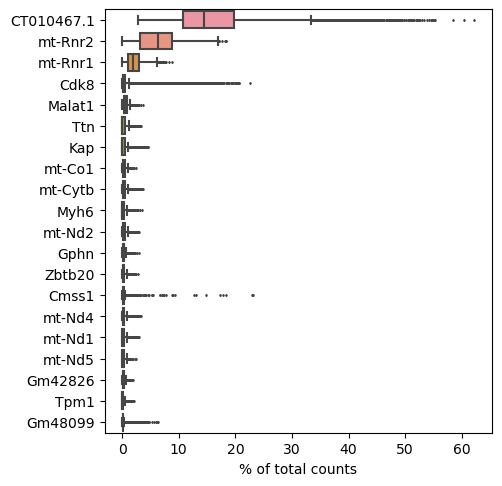

In [14]:
sc.plotting.highest_expr_genes(adata, n_top = 20)

## QC metrics

### Calculate QC metrics

In [15]:
adata.var['mt'] = adata.var_names.str.contains('MT-', case=False)  # annotate the group of mitochondrial genes as 'mt'

sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

### Plotting of QC metrics

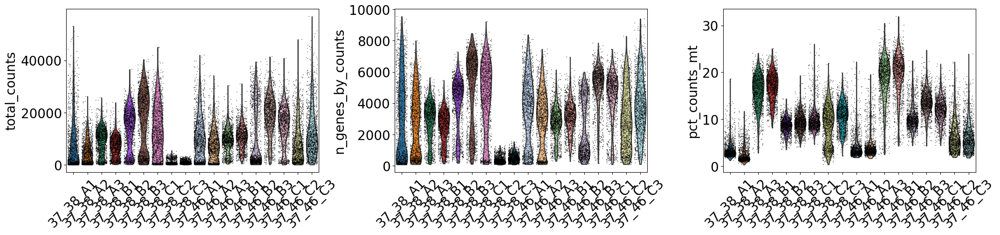

In [16]:
with plt.rc_context({'font.size': 20}):
    sc.pl.violin(adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt'], 
                 jitter=0.4, rotation=45,
                 multi_panel=True, groupby='id')

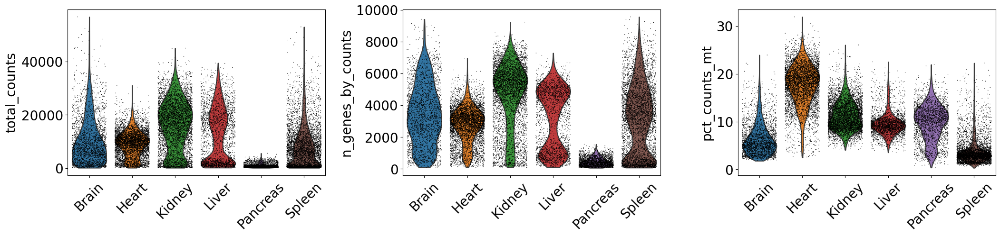

In [17]:
with plt.rc_context({'font.size': 20}):
    sc.pl.violin(adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt'], 
                 jitter=0.4, rotation=45,
                 multi_panel=True, groupby='organ',
                 save="_counts_genes_perOrgan.pdf", dpi=300)

#### Plot QC metrics colored by organ

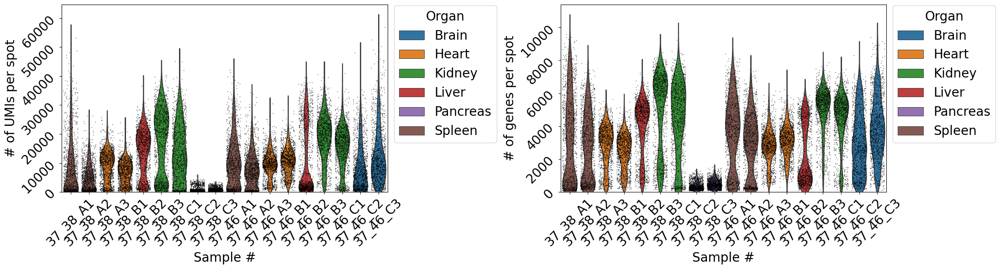

In [18]:
to_plot = ["total_counts", "n_genes_by_counts"]
labels = ["# of UMIs per spot", "# of genes per spot"]
fs=20

fig, axs = plt.subplots(1, len(to_plot), figsize=(11*len(to_plot), 6))

if len(to_plot) == 1:
    axs = [axs]

for i, val in enumerate(to_plot):
    sns.violinplot(x="id", y=val, inner=None, dodge=False, data=adata.obs, hue="organ", ax=axs[i])
    sns.stripplot(x="id", y=val, data=adata.obs, size=1, color='black', dodge=True, jitter=0.4, ax=axs[i])
    axs[i].set_ylim(0,None)
    axs[i].set_ylabel(labels[i], fontsize=fs)
    axs[i].set_xlabel("Sample #", fontsize=fs)
    legend = axs[i].legend(title="Organ", 
                           loc="upper left",
                           bbox_to_anchor=(1, 1.03),
                           fontsize=fs)
    axs[i].tick_params(axis='both', which='major', labelsize=fs, rotation=45)
    plt.setp(legend.get_title(),fontsize=fs)

plt.tight_layout()

plt.savefig("figures/qc.png", dpi=200, bbox_inches="tight")
plt.savefig("figures/qc.pdf", bbox_inches="tight")

plt.show()

## Check image registration

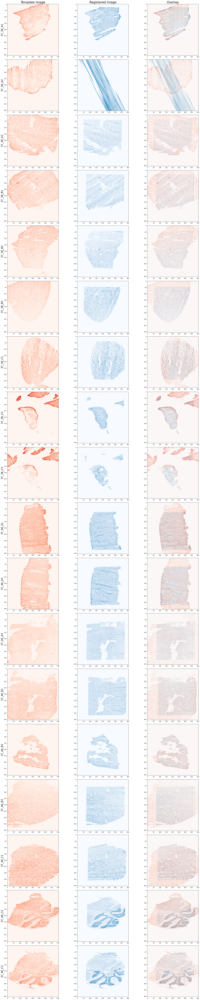

In [22]:
scale_factor = 0.1

indices = adata.obs['id'].unique()

fig, axs = plt.subplots(len(indices), 3, figsize=(8*3, 6*len(indices)))

for i, idx in enumerate(indices):
    # fetch images
    img_key = '{}-dapi'.format(idx)
    img = adata.uns['spatial'][img_key]['images']['lowres']
    img_reg = adata.uns['registered'][idx]
    
    # get scale factor and resize registered image for plotting
    sf = adata.uns['spatial'][img_key]['scalefactors']['tissue_lowres_scalef']
    img_reg = db.im.resize_image(img_reg, scale_factor=sf)
    
    # do plotting
    axs[i, 0].imshow(db.im.resize_image(img, scale_factor=scale_factor), cmap="Reds", alpha=1)
    axs[i, 1].imshow(db.im.resize_image(img_reg, scale_factor=scale_factor), cmap="Blues", alpha=1)

    axs[i, 2].imshow(db.im.resize_image(img, scale_factor=scale_factor), cmap="Reds", alpha=1)
    axs[i, 2].imshow(db.im.resize_image(img_reg, scale_factor=scale_factor), cmap="Blues", alpha=0.5)
    
    axs[i, 0].set_ylabel(idx, fontsize=20)
    
    if i == 0:
        axs[i, 0].set_title('Template image', fontsize=24)
        axs[i, 1].set_title('Registered image', fontsize=24)
        axs[i, 2].set_title('Overlay', fontsize=24)

fig.tight_layout()

plt.savefig("figures/registration_overview.png", dpi=200)
plt.show()

## Results until here - Selection of datasets:

### Registration
- Registration worked for most samples but not for all.
- Samples where the registration did not work as wished:
    - 37_38_A1 - Spleen
    - 37_38_A2 - Spleen
    - 37_38_C3 - Pancreas
    
### Transcriptomic quality
- The transcriptomic quality of following samples is too low:
    - 37_38_C2 - Pancreas
    - 37_38_C3 - Pancreas
    
    
### Summary

#### Substitute HQ images with Alignment images for following datasets:
    - 37_38_A1
    - 37_38_A2

#### Remove following datasets completely for further analysis:
    - 37_38_C2
    - 37_38_C3
    
#### For preprocessing see notebook 02

# RNA Metrics

In [23]:
anndata_dirs

['D:/data/37_38/anndata/', 'D:/data/37_46/anndata/']

In [30]:
# give directories with anndata files
raw_dirs = [
    "D:/data/37_38/CountsToAnndata/",
    "D:/data/37_46/CountsToAnndata/"
]

# get list of files
metric_files = []
for d in raw_dirs:
    metric_files.extend(glob(os.path.join(d, "Sample_*", "out", "*.RNA_Metrics")))

In [31]:
metric_files

['D:/data/37_38/CountsToAnndata\\Sample_21L002411\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002412\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002413\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002414\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002415\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002416\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002417\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002418\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_38/CountsToAnndata\\Sample_21L002419\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_46/CountsToAnndata\\Sample_22L000005\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_46/CountsToAnndata\\Sample_22L000006\\out\\rnaseq_metrics.RNA_Metrics',
 'D:/data/37_46/CountsToAnndata\\Sample_22L000007\\out\\rnaseq_me

## Pie chart

In [32]:
data_names = sorted(list(adata.obs['id'].unique()))
data_names = [elem.replace("_", "\_") for elem in data_names]

In [34]:
metrics = db.tl.read_rna_metrics(rnametrics_files=metric_files, data_names=data_names)

Saving figure to file figures/RNAmetrics_pie.pdf
Saved.


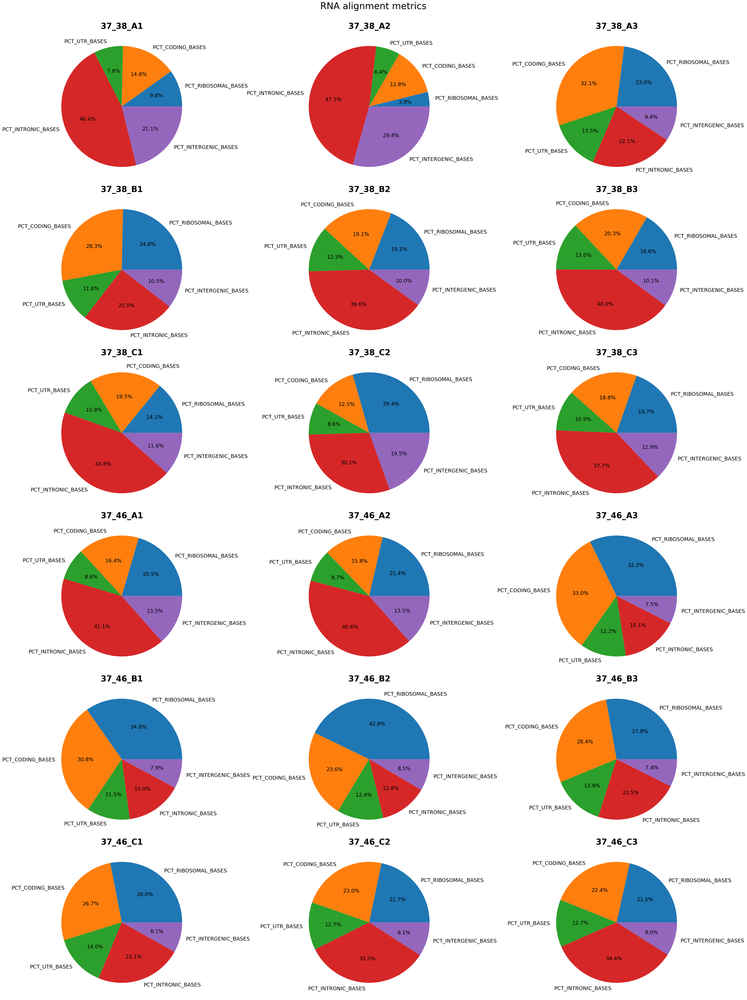

In [36]:
db.pl.rna_metrics_pie(metrics, max_cols=3, savepath="figures/RNAmetrics_pie.pdf")

## Stacked barplot

In [39]:
categories = ['PCT_RIBOSOMAL_BASES', 'PCT_CODING_BASES', 'PCT_UTR_BASES',
       'PCT_INTRONIC_BASES', 'PCT_INTERGENIC_BASES']

# reshape data
reshaped = metrics.reset_index().drop('level_1', axis=1).rename(columns={'level_0': 'id'})
reshaped = reshaped.pivot(index='id', columns='metric')
reshaped.columns = reshaped.columns.droplevel(0)
reshaped = reshaped.iloc[:, reshaped.columns.isin(categories)]

# change index names
reshaped.index = [elem.replace("\_", "_") for elem in reshaped.index]

# convert values to numeric
for cat in categories:
    reshaped[cat] = pd.to_numeric(reshaped[cat])

# make sure that every row has the sum 1
reshaped = reshaped.apply(lambda x: x/x.sum(), axis=1)

# add information about organs
id_organ_dict = {row['id']: row['organ'] for i, row in adata.obs.groupby('id').head(1).iterrows()}
reshaped['organ'] = [id_organ_dict[i] for i in reshaped.index]

In [40]:
reshaped

metric,PCT_CODING_BASES,PCT_INTERGENIC_BASES,PCT_INTRONIC_BASES,PCT_RIBOSOMAL_BASES,PCT_UTR_BASES,organ
37_38_A1,0.148353,0.211383,0.463852,0.098442,0.077970,Spleen
37_38_A2,0.128288,0.293531,0.475382,0.038887,0.063912,Spleen
37_38_A3,0.320737,0.093657,0.220591,0.229984,0.135030,Heart
37_38_B1,0.283299,0.104624,0.249773,0.246485,0.115818,Heart
37_38_B2,0.191112,0.099731,0.395712,0.190822,0.122624,Liver
37_38_B3,0.203389,0.100710,0.399582,0.166312,0.130008,Kidney
37_38_C1,0.194732,0.115969,0.438468,0.141449,0.109382,Kidney
37_38_C2,0.125438,0.194702,0.300508,0.293838,0.085513,Pancreas
37_38_C3,0.187760,0.129271,0.377047,0.196544,0.109378,Pancreas
37_46_A1,0.163702,0.135010,0.411185,0.204538,0.085565,Spleen


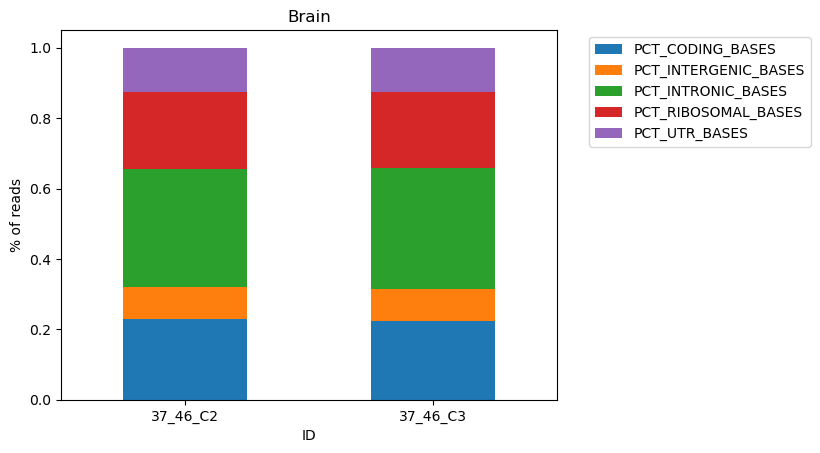

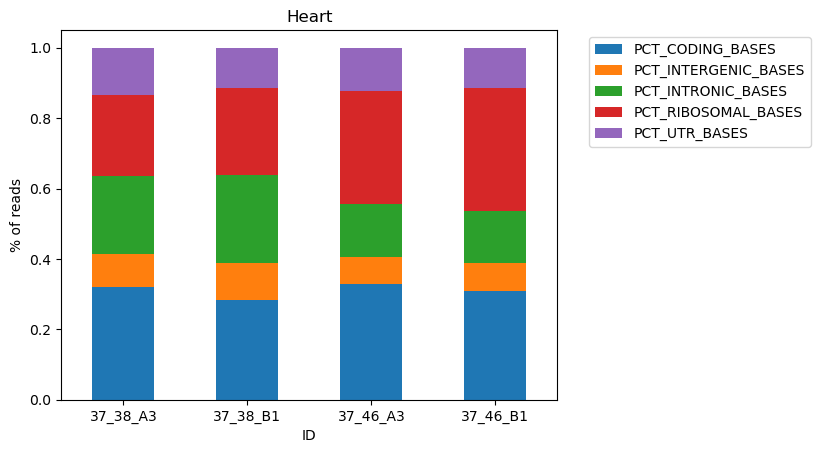

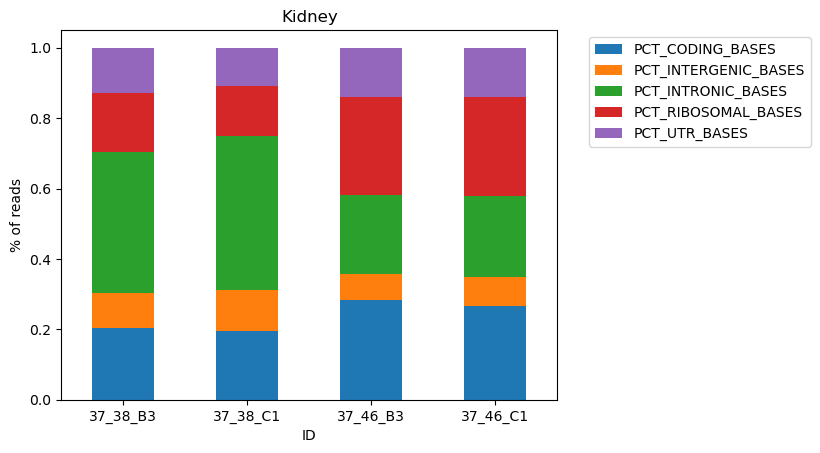

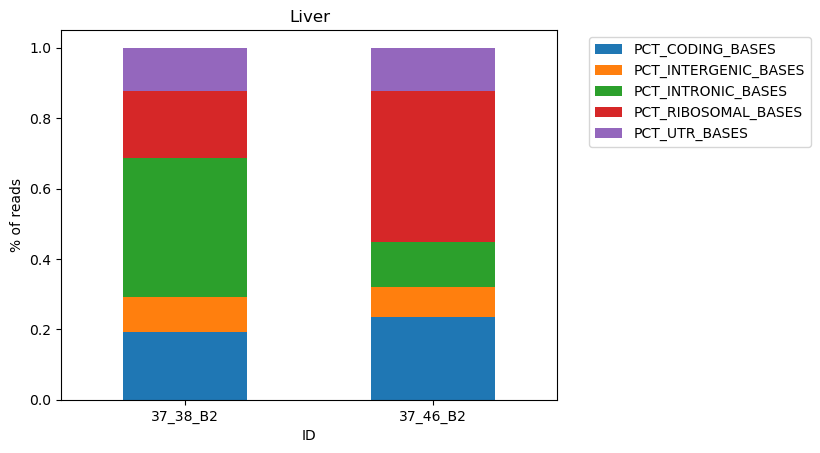

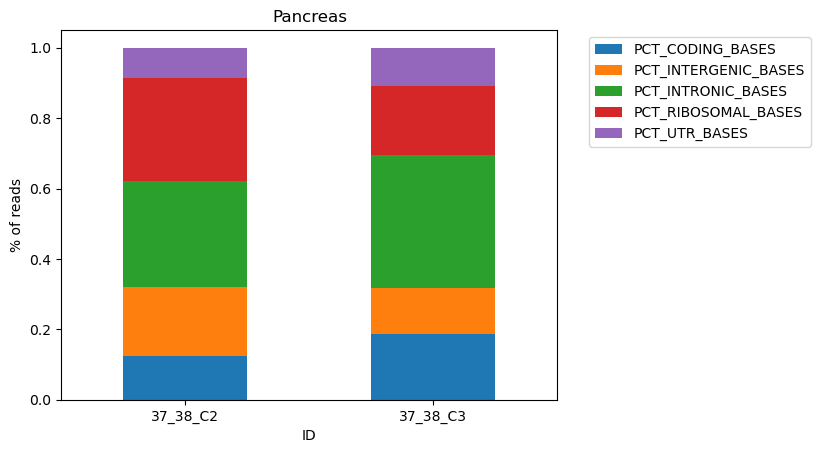

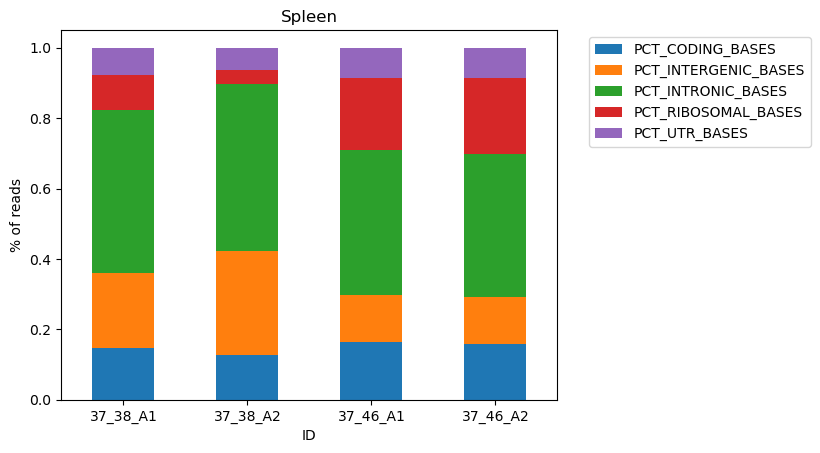

In [41]:
axs = reshaped.groupby('organ').plot(kind='bar', stacked=True, rot=0)

for organ in axs.index:
    axs[organ].set_title(organ)
    axs[organ].set_xlabel('ID')
    axs[organ].set_ylabel('% of reads')
    axs[organ].legend(bbox_to_anchor=(1.05, 1.0))
    
    fig = axs[organ].get_figure()
    fig.savefig("figures/RNAmetrics_stacked_{}.pdf".format(organ), bbox_inches='tight')